# **CLIP: Creating Image Classifiers Without Data**
A hands-on tutorial explaining how to generate a custom Zero-Shot image classifier without training, using a pre-trained CLIP model. Full code included.

The CLIP (Contrastive Language-Image Pre-training) model, developed by OpenAI, is a multi-modal vision and language model. It maps images and text descriptions to the same latent space, allowing it to determine whether an image and description match.

Reference:
1. https://towardsdatascience.com/clip-creating-image-classifiers-without-data-b21c72b741fa

2. https://gist.github.com/Lihi-Gur-Arie/9356a2018c3420a01e3033875405f605

In [ ]:
!pip install clip-by-openai
!pip install pandas
!pip install -U scikit-learn
!pip install opendatasets
!pip install ipywidgets
!pip install clip
!jupyter nbextension enable --py widgetsnbextension --sys-prefix

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 3.1 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of clip-by-openai to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 23.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 32.2 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of clip-by-openai to determine which version is compatible with other requirements. This could take a while.
ERROR: Cannot install clip-by-openai==0.1.0, clip-by-openai==0.1.1, clip-by-openai==0.1.1.2, clip-by-openai==0.1.1.3, clip-by-openai==0.1.1.4, cl

To use OpenAI's CLIP, you should use the openai/CLIP repository. You can install it using the clip package provided by OpenAI's repository.

In [ ]:
!pip install git+https://github.com/openai/CLIP.git

In [ ]:
import numpy as np
import torch
import os
import clip
from PIL import Image
from tqdm.notebook import tqdm
import pandas as pd
from sklearn.metrics import accuracy_score
import zipfile
import random
from IPython.display import display, Image as IPyImage, HTML

‘Glasses or No Glasses’ dataset from Kaggle, license CC BY-SA 4.0: https://www.kaggle.com/datasets/jeffheaton/glasses-or-no-glasses

In [ ]:
!kaggle datasets download -d jeffheaton/glasses-or-no-glasses
# Extract zip dataset
with zipfile.ZipFile('glasses-or-no-glasses.zip', 'r') as zip_ref:
    zip_ref.extractall()

Dataset URL: https://www.kaggle.com/datasets/jeffheaton/glasses-or-no-glasses
License(s): CC-BY-SA-4.0
100% 6.10G/6.11G [01:26<00:00, 70.9MB/s]
100% 6.11G/6.11G [01:26<00:00, 76.0MB/s]


In [ ]:
def display_random_images(dir_path, num_images, seed, save_path=None):
    random.seed(seed)
    image_paths = []
    for subdir, dirs, files in os.walk(dir_path):
        for file in files:
            file_path = os.path.join(subdir, file)
            if file_path.endswith(".png") or file_path.endswith(".jpg") or file_path.endswith(".jpeg"):
                image_paths.append(file_path)

    random_images = random.sample(image_paths, num_images)

    images = [Image.open(image_path) for image_path in random_images]
    widths, heights = zip(*(i.size for i in images))

    total_width = sum(widths)
    max_height = max(heights)

    new_im = Image.new('RGB', (total_width, max_height))

    x_offset = 0
    for im in images:
        new_im.paste(im, (x_offset,0))
        x_offset += im.size[0]

    if save_path:
        new_im.save(save_path)

    display(new_im)

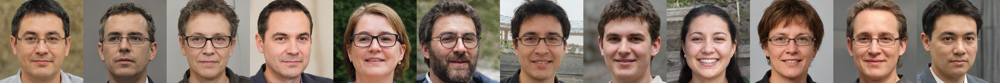

In [ ]:
display_random_images(dir_path = 'faces-spring-2020', num_images=12, seed = 12, save_path = 'random_data.jpg')

In [ ]:
class CustomClassifier:

    def __init__(self, prompts):
        self.class_prompts = prompts
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model, self.preprocess = clip.load("RN50", device=self.device)  # "ViT-B/32"
        self.preprocessed_text = clip.tokenize(self.class_prompts).to(self.device)
        print(f'Classes Prompts: {self.class_prompts}')

    def classify(self, image_path, y_true=None):
        preprocessed_image = self.preprocess(Image.open(image_path)).unsqueeze(0).to(self.device)

        with torch.no_grad():
            image_logits, _ = self.model(preprocessed_image, self.preprocessed_text)
            proba_list = image_logits.softmax(dim=-1).cpu().numpy()[0]

        y_pred = np.argmax(proba_list)
        y_pred_proba = np.max(proba_list)
        y_pred_token = self.class_prompts[y_pred]
        results = pd.DataFrame([{'image': image_path, 'y_true': y_true, 'y_pred': y_pred, 'y_pred_token': y_pred_token, 'proba': y_pred_proba}])

        # User-friendly message
        if y_pred_token == 'glasses':
            print(f"The person in the image is wearing glasses with a confidence of {y_pred_proba:.2f}.")
        else:
            print(f"The person in the image is not wearing glasses with a confidence of {y_pred_proba:.2f}.")

        # User-friendly message
        if y_pred_token == 'glasses':
            message = f"The person in the image is wearing glasses with a confidence of {y_pred_proba:.2f}."
        else:
            message = f"The person in the image is not wearing glasses with a confidence of {y_pred_proba:.2f}."

        # Display image and message
        display(HTML(f"""
        <div style="display: flex; align-items: center;">
            <div style="flex: 1;">
                <img src="{image_path}" alt="Image" style="max-width: 100%;">
            </div>
            <div style="flex: 1; padding-left: 20px;">
                <h3>Classification Result: </h3>
                <p>{message}</p>
            </div>
        </div>
        """))

        # Display image and message using IPython.display for Colab compatibility
        display(IPyImage(filename=image_path))

        return results

    def validate(self, dataset, max_images):
        df_results = pd.DataFrame()
        for sample in tqdm(range(max_images)):
            image_path, class_idx = dataset[sample]
            image_results = self.classify(image_path, class_idx)
            df_results = pd.concat([df_results, image_results])

        accuracy = accuracy_score(df_results.y_true, df_results.y_pred)
        print(f'Accuracy - {round(accuracy, 2)}')
        return accuracy, df_results

Classes Prompts: ['no glasses', 'glasses']
The person in the image is wearing glasses with a confidence of 0.83.


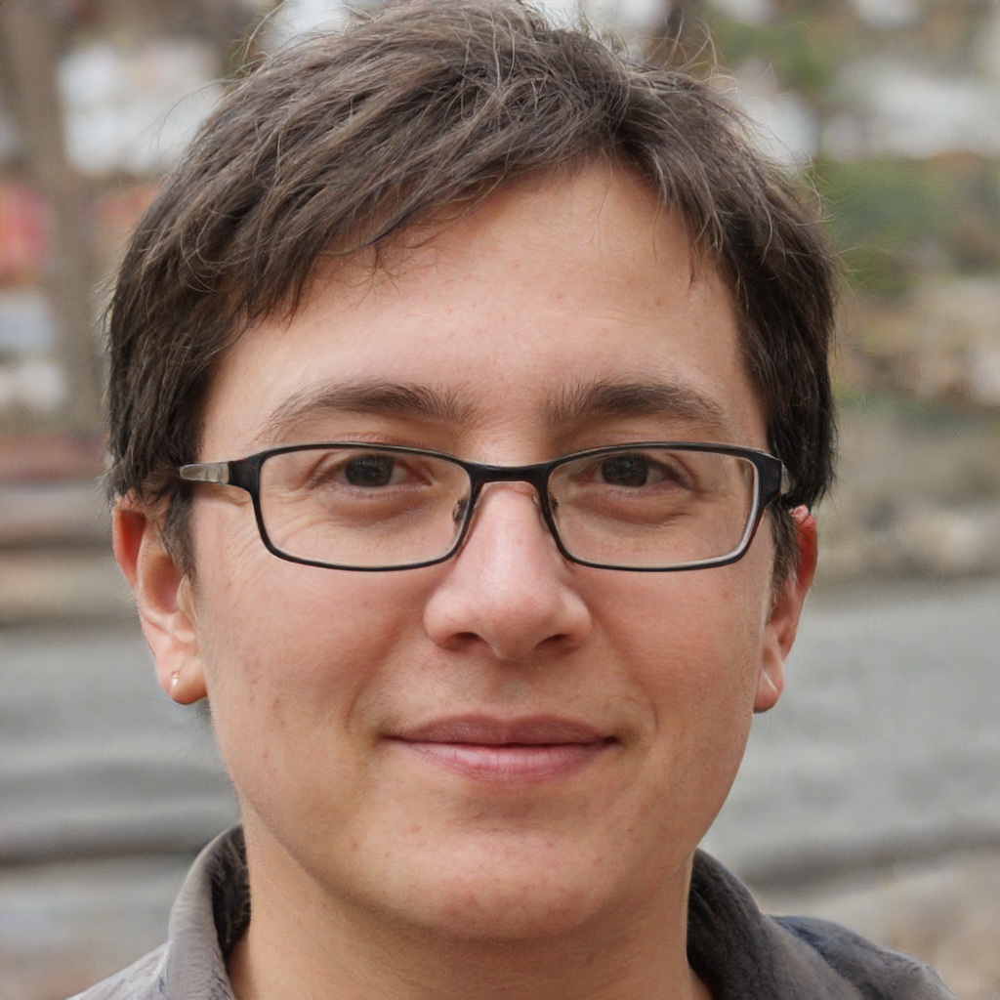

                                               image y_true  y_pred  \
0  /content/faces-spring-2020/faces-spring-2020/f...   None       1   

  y_pred_token    proba  
0      glasses  0.82894  
Classes Prompts: ['no glasses', 'glasses']
The person in the image is not wearing glasses with a confidence of 0.83.


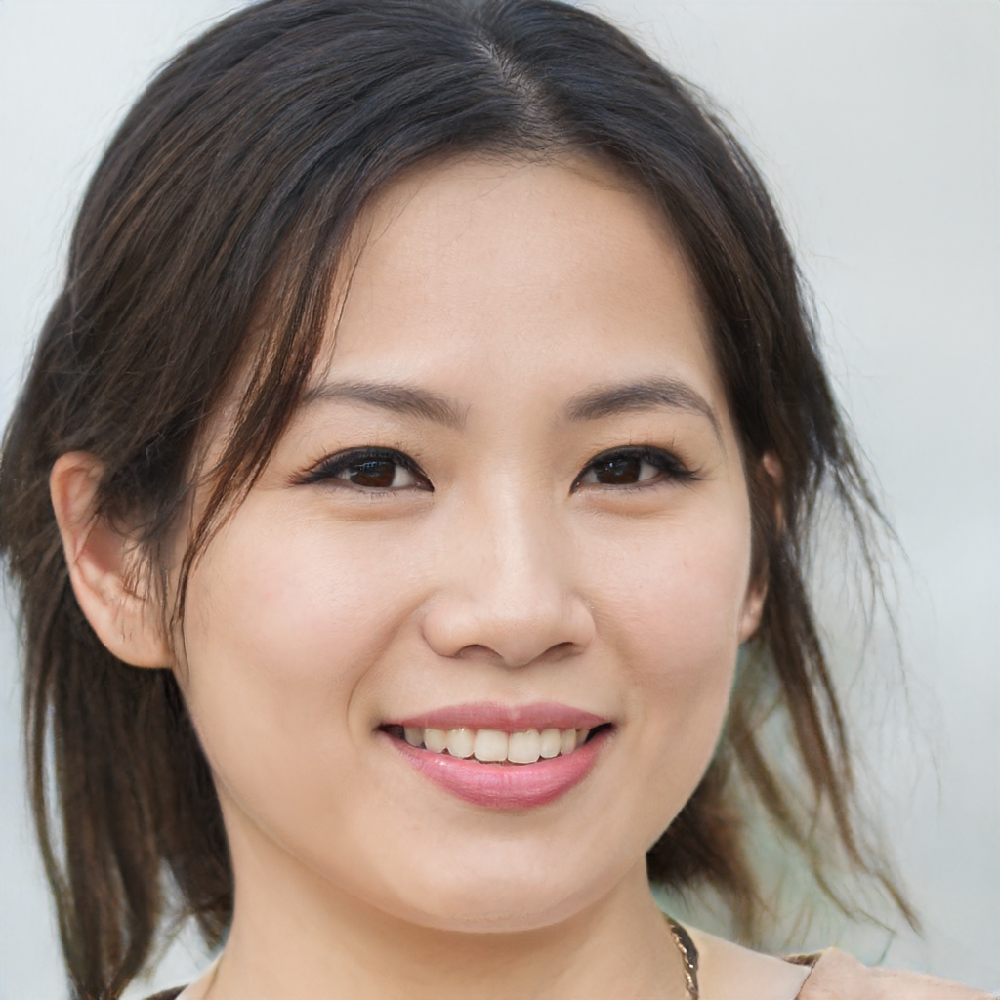

                                               image y_true  y_pred  \
0  /content/faces-spring-2020/faces-spring-2020/f...   None       0   

  y_pred_token     proba  
0   no glasses  0.833327  


In [ ]:
prompts = ['no glasses','glasses']
image_path = '/content/faces-spring-2020/faces-spring-2020/face-100.png'
image_results = CustomClassifier(prompts).classify(image_path)
print(image_results)

image_path = '/content/faces-spring-2020/faces-spring-2020/face-1007.png'
image_results = CustomClassifier(prompts).classify(image_path)
print(image_results)


